# Evaluate SimCLR

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from simple_model.model import SimCLR, train_simclr
from simple_model.dataloader import PairedContrastiveDataset, make_set

In [3]:
import os
os.environ["CUDA_LAUNCH_BLOCKING"] = "1"
os.environ['TENSORBOARD_BINARY'] = '/p/project1/hai_fzj_bda/koenig8/jupyter/kernels/contrastive_learn/bin/tensorboard'

import pytorch_lightning as pl
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import matplotlib.pyplot as plt
from plotnine import *
from torch.utils.data import TensorDataset, DataLoader
import sklearn.preprocessing as pp
from sklearn.metrics.pairwise import paired_distances
from sklearn.neighbors import NearestNeighbors
from sklearn.metrics import r2_score, silhouette_score

import scanpy as sc
import pandas as pd
from tqdm import tqdm

### Load the model and data

In [4]:
model = SimCLR.load_from_checkpoint(
    "/p/project1/hai_fzj_bda/koenig8/cl/run_simclr/second_run/logs/second_run/version_4/checkpoints/epoch=6-step=186683.ckpt"
)
model.eval()
model.histo_model

SimpleModel(
  (model): Sequential(
    (0): Linear(in_features=368, out_features=1024, bias=True)
    (1): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Dropout(p=0.1, inplace=False)
    (4): Linear(in_features=1024, out_features=512, bias=True)
    (5): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (6): ReLU()
    (7): Dropout(p=0.1, inplace=False)
    (8): Linear(in_features=512, out_features=64, bias=True)
    (9): L2NormalizationLayer()
  )
)

In [5]:
path = "/p/project1/hai_fzj_bda/koenig8/ot/data/"
adata_st = sc.read_h5ad(os.path.join(path, "adata_st.h5ad"))
adata_histo = sc.read_h5ad(os.path.join(path, "adata_histo.h5ad"))
adata_histo = adata_histo[adata_histo.obs.in_sample]
adata_st, adata_histo 

(AnnData object with n_obs × n_vars = 50000 × 50
     obs: 'patch_id', 'brain_area', 'patchsize', 'x_st', 'y_st', 'z_st', 'brain_section_label', 'section', 'test_set', 'val_set', 'train_set'
     uns: 'neighbors', 'umap'
     obsm: 'X_umap', 'brain_area_onehot', 'brain_area_similarities', 'pca_embedding', 'pca_plus_slides', 'pca_plus_slides_scaled'
     obsp: 'connectivities', 'distances',
 View of AnnData object with n_obs × n_vars = 50000 × 1536
     obs: 'image_id', 'patchsize', 'center_ccf', 'pixel_coord', 'distance', 'nearest_ST', 'nearest_cell_id', 'target_atlas_plate', 'distance_new', 'x', 'y', 'z', 'x_st', 'y_st', 'z_st', 'image_nr', 'brain_area', 'group', 'slice', 'in_sample', 'test_set', 'val_set', 'train_set'
     obsm: 'brain_area_onehot', 'brain_area_similarities', 'uni_embedding', 'uni_pca_95', 'uni_pca_plus_coords')

In [14]:
def embed_data(mdl, ad_a, ad_b, batch_size=20000):
    st_dataloader = DataLoader(TensorDataset(
        torch.tensor(ad_a.obsm["pca_embedding"], dtype=torch.float32)
    ), batch_size = batch_size, shuffle=False, pin_memory=False)
    st_embeddings = []
    
    histo_dataloader = DataLoader(TensorDataset(
        torch.tensor(ad_b.obsm["uni_pca_95"], dtype=torch.float32)
    ), batch_size = batch_size, shuffle=False, pin_memory=False)
    histo_embeddings = []
    
    with torch.no_grad():
        for batch, in st_dataloader:
            emb = mdl.st_model(batch)
            st_embeddings.append(emb)
        for batch, in histo_dataloader:
            emb = mdl.histo_model(batch)
            histo_embeddings.append(emb)
        st_embeddings = torch.vstack(st_embeddings).numpy()
        histo_embeddings = torch.vstack(histo_embeddings).numpy()
    return st_embeddings, histo_embeddings

st_embeddings, histo_embeddings = embed_data(model, adata_st, adata_histo)

st_embeddings.shape, histo_embeddings.shape

((50000, 218), (50000, 218))

### Plot a UMAP of the model embeddings

In [7]:
def plot_umap(adata_src, adata_target, emb_src, emb_target):
    set1 = set(list(adata_src.obs["brain_area"]))
    set2 = set(list(adata_target.obs["brain_area"]))
    cats = list(set1 | set2)
    cmap = plt.get_cmap("tab20")
    color_map = {cat: cmap(i / len(cats)) for i, cat in enumerate(cats)}
    
    adata = sc.concat(
        [adata_src, adata_target],
        join="outer",
        label="batch",
        keys=["ST (translated)", "Histo"],
    )
    adata.obsm["X_latent"] = np.concatenate(
        (emb_src, emb_target), axis=0
    )
    sc.pp.neighbors(adata, use_rep="X_latent")
    sc.tl.umap(adata)
    
    fig_umap, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(5, 13))
    
    sc.pl.umap(adata, color=["batch"], ax=ax1, show=False)
    ax1.legend()
    ax1.set_title("Colored based on modality")
    
    sc.pl.umap(adata, color=["brain_area"], ax=ax2, show=False)
    ax2.set_title("Colored based on brain areas")
    
    adata.obs["distance_to_origin"] = np.sqrt(np.sum(
        np.square(adata.obs.loc[:, ["x_st", "y_st", "z_st"]].to_numpy()), axis = 1
    ))
    sc.pl.umap(adata, color=["distance_to_origin"], ax=ax3, show=False)
    ax3.set_title("Colored based on distance to origin in ccf")
    return fig_umap

/p/project1/hai_fzj_bda/koenig8/jupyter/kernels/contrastive_learn/lib/python3.10/site-packages/anndata/_core/anndata.py:1756: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
/p/project1/hai_fzj_bda/koenig8/jupyter/kernels/contrastive_learn/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html


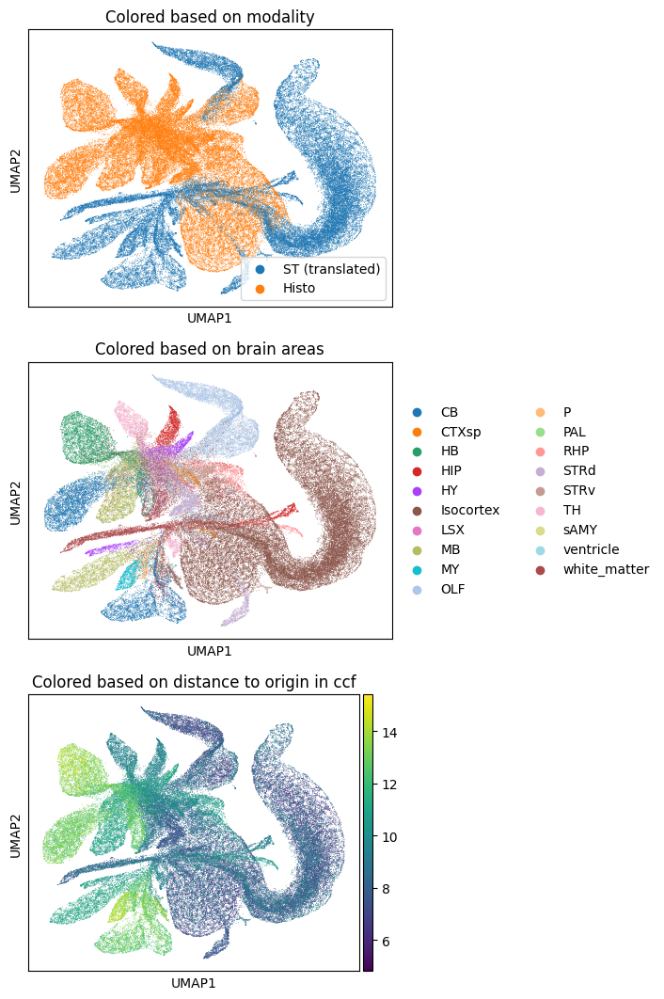

In [10]:
fig = plot_umap(adata_st, adata_histo, st_embeddings, histo_embeddings)
plt.show()

## Plot the UMAP only for validation points

In [8]:
val_cond_st = adata_st.obs.val_set
ad_val_st = adata_st[val_cond_st]

val_cond_histo = adata_histo.obs.val_set
ad_val_histo = adata_histo[val_cond_histo]

/p/project1/hai_fzj_bda/koenig8/jupyter/kernels/contrastive_learn/lib/python3.10/site-packages/anndata/_core/anndata.py:1756: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


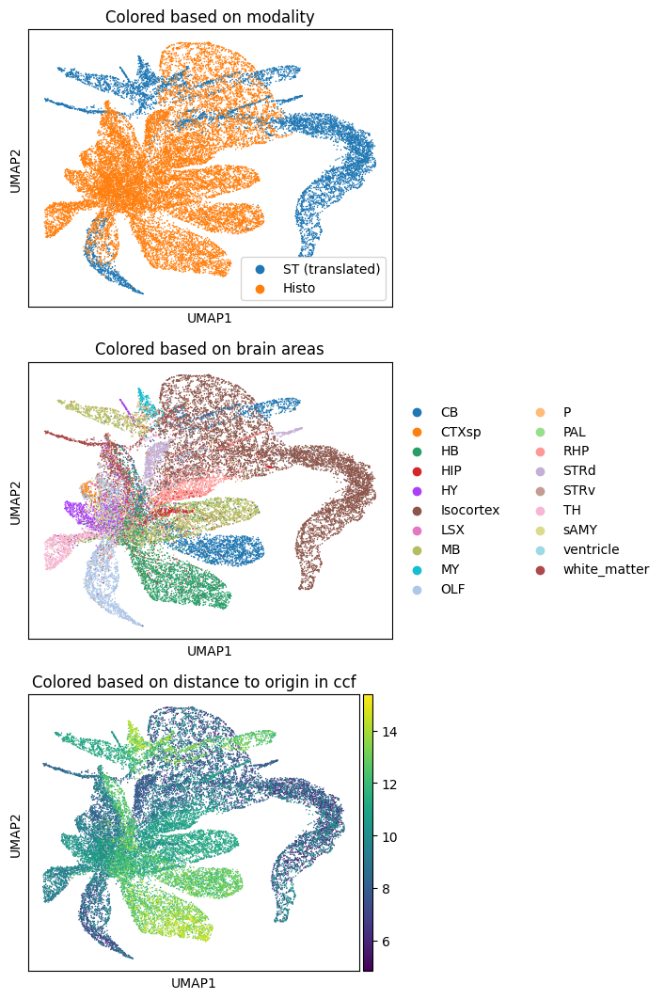

In [32]:
fig = plot_umap(ad_val_st, ad_val_histo, st_embeddings[val_cond_st], histo_embeddings[val_cond_histo])
plt.show()

### Try l2 norm

/p/project1/hai_fzj_bda/koenig8/jupyter/kernels/contrastive_learn/lib/python3.10/site-packages/anndata/_core/anndata.py:1756: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


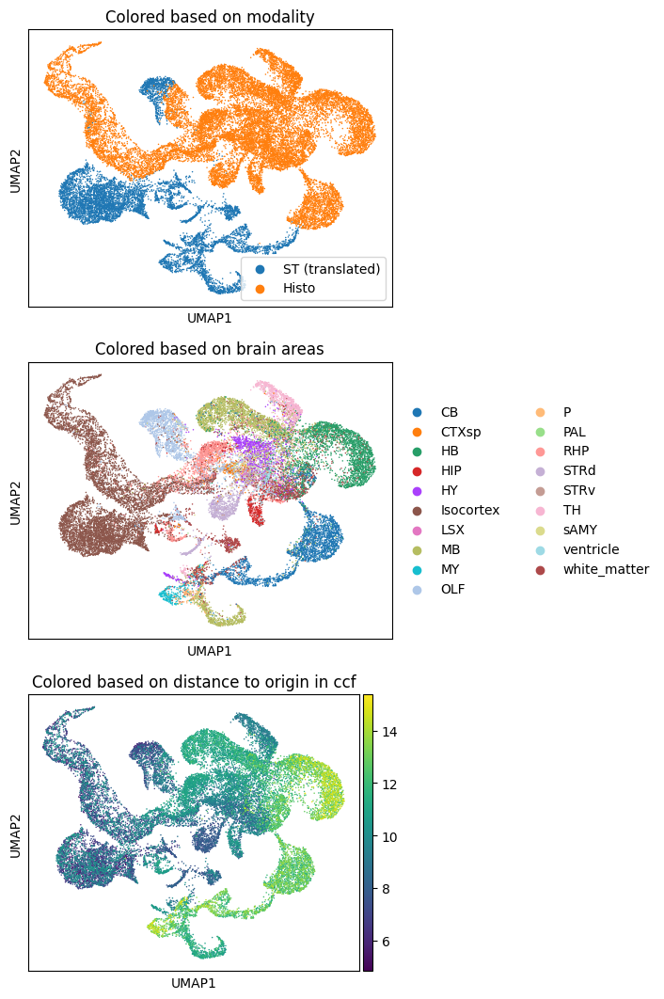

In [20]:
norm_embedding = pp.normalize()
fig = plot_umap(val_st[0], val_histo[0], pp.normalize(val_st[1]), pp.normalize(val_histo[1]))
plt.show()

## Try a different model

In [9]:
model2 = SimCLR.load_from_checkpoint(
    "/p/project1/hai_fzj_bda/koenig8/cl/run_simclr/third_run/logs/third_run/version_2/checkpoints/epoch=1-step=53338.ckpt"
)
model2.eval()
model2.histo_model

SimpleModel(
  (model): Sequential(
    (0): Linear(in_features=368, out_features=512, bias=True)
    (1): ReLU()
    (2): Dropout(p=0.3, inplace=False)
    (3): Linear(in_features=512, out_features=480, bias=True)
  )
)

In [10]:
st_2, histo_2 = embed_data(model2, adata_st, adata_histo)

st_2.shape, histo_2.shape

((50000, 480), (50000, 480))

/p/project1/hai_fzj_bda/koenig8/jupyter/kernels/contrastive_learn/lib/python3.10/site-packages/anndata/_core/anndata.py:1756: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


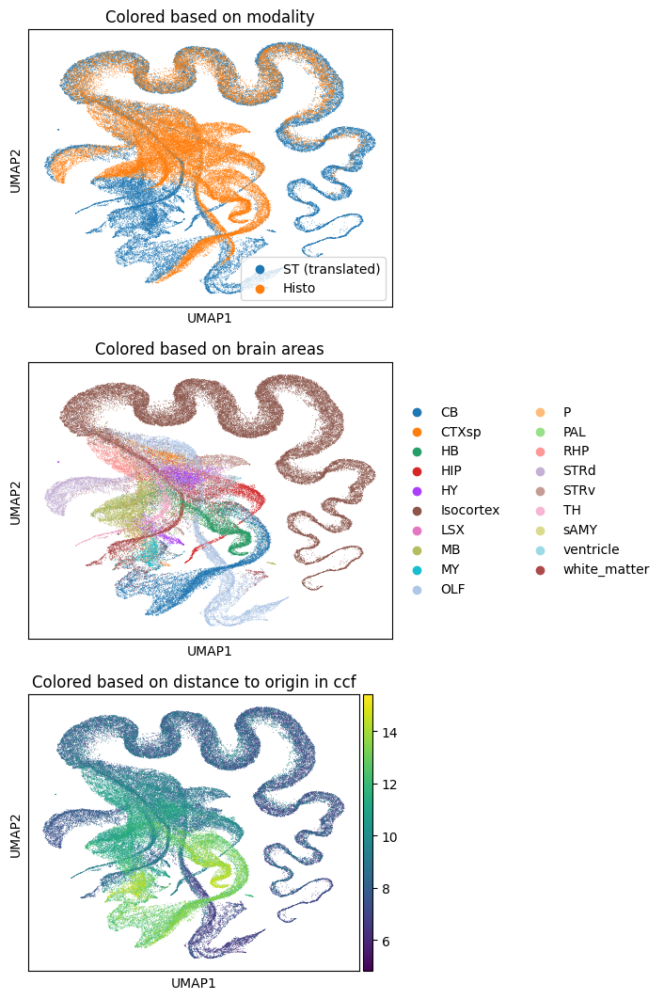

In [23]:
plot_umap(adata_st, adata_histo, st_2, histo_2)
plt.show()

## Plot again for validation

/p/project1/hai_fzj_bda/koenig8/jupyter/kernels/contrastive_learn/lib/python3.10/site-packages/anndata/_core/anndata.py:1756: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


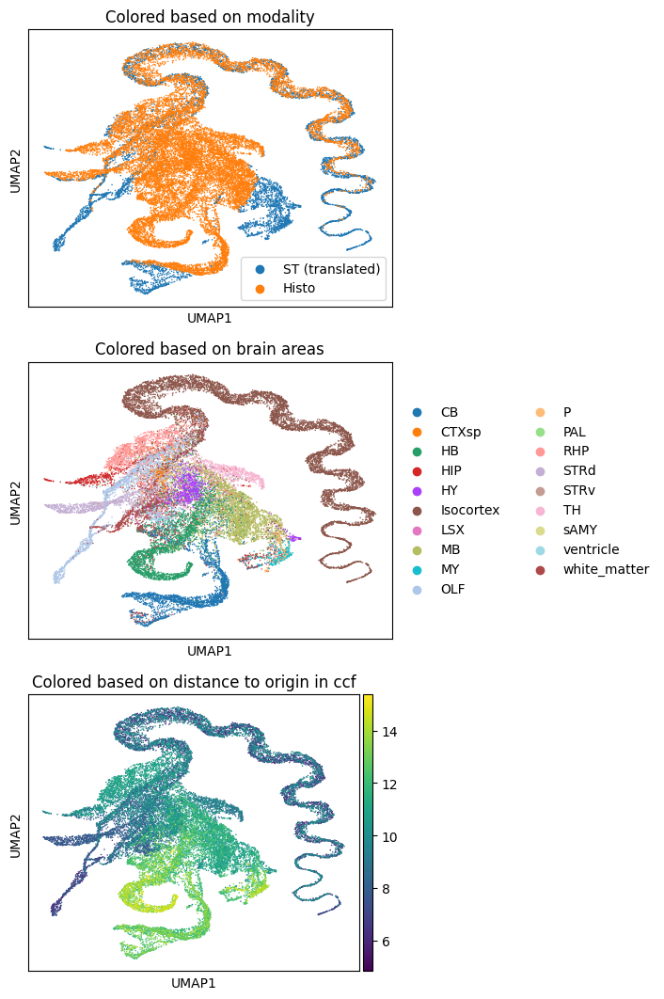

In [33]:
fig = plot_umap(ad_val_st, ad_val_histo, st_2[val_cond_st], histo_2[val_cond_histo])
plt.show()

## Look at scores

## Get a baseline of interpolation scores by looking at nearest neighbors

In [9]:
histo_points = adata_histo.obs.loc[:, ("x_st", "y_st", "z_st")].to_numpy()
st_points = adata_st.obs.loc[:, ("x_st", "y_st", "z_st")].to_numpy()

nn = NearestNeighbors(n_neighbors=1, algorithm='auto')
nn.fit(histo_points)
dist_coords, ind_coords = nn.kneighbors(st_points)

# Flatten to get simple 1D arrays
ind_coords = ind_coords.flatten()
dist_coords = dist_coords.flatten()
np.mean(dist_coords)

np.float64(0.11397089101830145)

They are about 0.1 micrometers apart, let's calculate the R²

In [16]:
r2_score(st_points, histo_points[ind_coords])

0.9984226474304095

==> Almost perfect, now let's look at the 1NN of our 2nd model

### Baseline for native histo and st embeddings

In [8]:
st_data = adata_st.obsm["pca_embedding"]
histo_data = adata_histo.obsm["uni_pca_95"]
mods = ("Spatial", "Histo")
baseline_neighbors = []
baseline_predictions = []

for mod, emb, ad, points in zip(mods, (st_data, histo_data), (adata_st, adata_histo), (st_points, histo_points)):
    nn = NearestNeighbors(n_neighbors=1, algorithm='auto')
    train_emb = emb[ad.obs.train_set]
    val_emb = emb[ad.obs.val_set]
    nn.fit(train_emb)
    _, ind = nn.kneighbors(emb[ad.obs.val_set])
    
    # Flatten to get simple 1D arrays
    ind = ind.flatten()
    baseline_neighbors.append(ind)
    baseline_predictions.append(r2_score(points[ad.obs.val_set], points[ad.obs.train_set][ind]))

baseline = pd.DataFrame(baseline_predictions, columns = ["R²",], index = mods)

NameError: name 'st_points' is not defined

In [20]:
baseline

,R²
Spatial,0.562618
Histo,0.342422


In [21]:
nn = NearestNeighbors(n_neighbors=1, algorithm='auto')
nn.fit(histo_2)
_, ind_model = nn.kneighbors(st_2)

# Flatten to get simple 1D arrays
ind_model = ind_model.flatten()

OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detec

In [22]:
np.mean(paired_distances(st_points, histo_points[ind_model]))

np.float64(3.0037374253507543)

In [20]:
r2_score(st_points, histo_points[ind_model])

-0.12817303947513856

==> Not very good, about 3 microns apart. Let's see how well it works when we use it un the UMAP embedding, since here the coordinates seem to cluster

In [26]:
adata = sc.concat(
        [adata_st, adata_histo],
        join="outer",
        label="batch",
        keys=["ST (translated)", "Histo"],
)
adata.obsm["X_model2"] = np.concatenate(
    (st_2, histo_2), axis=0
)
sc.pp.neighbors(adata, use_rep="X_model2")
sc.tl.umap(adata)
adata.obsm["X_umap"].shape

/p/project1/hai_fzj_bda/koenig8/jupyter/kernels/contrastive_learn/lib/python3.10/site-packages/anndata/_core/anndata.py:1756: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


(100000, 2)

In [28]:
nn = NearestNeighbors(n_neighbors=1, algorithm='auto')
UMAP_st = adata[adata.obs.batch == "ST (translated)"].obsm["X_umap"]
UMAP_histo = adata[adata.obs.batch != "ST (translated)"].obsm["X_umap"]
nn.fit(UMAP_histo)
_, ind_umap = nn.kneighbors(UMAP_st)

# Flatten to get simple 1D arrays
ind_umap = ind_umap.flatten()

In [29]:
np.mean(paired_distances(st_points, histo_points[ind_umap]))

np.float64(3.1869275871878857)

In [30]:
r2_score(st_points, histo_points[ind_umap])

-0.17990938707668538

==> Even worse

# The same model, but trained much longer (for 33 epochs)

In [9]:
model3 = SimCLR.load_from_checkpoint(
    "/p/project1/hai_fzj_bda/koenig8/cl/run_simclr/third_run/logs/third_run/version_3/checkpoints/epoch=33-step=906746.ckpt"
)
model3.eval()
model3.histo_model

SimpleModel(
  (model): Sequential(
    (0): Linear(in_features=368, out_features=512, bias=True)
    (1): ReLU()
    (2): Dropout(p=0.3, inplace=False)
    (3): Linear(in_features=512, out_features=480, bias=True)
  )
)

In [11]:
st_3, histo_3 = embed_data(model3, adata_st, adata_histo)

st_3.shape, histo_3.shape

((50000, 480), (50000, 480))

/p/project1/hai_fzj_bda/koenig8/jupyter/kernels/contrastive_learn/lib/python3.10/site-packages/anndata/_core/anndata.py:1756: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
/p/project1/hai_fzj_bda/koenig8/jupyter/kernels/contrastive_learn/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html


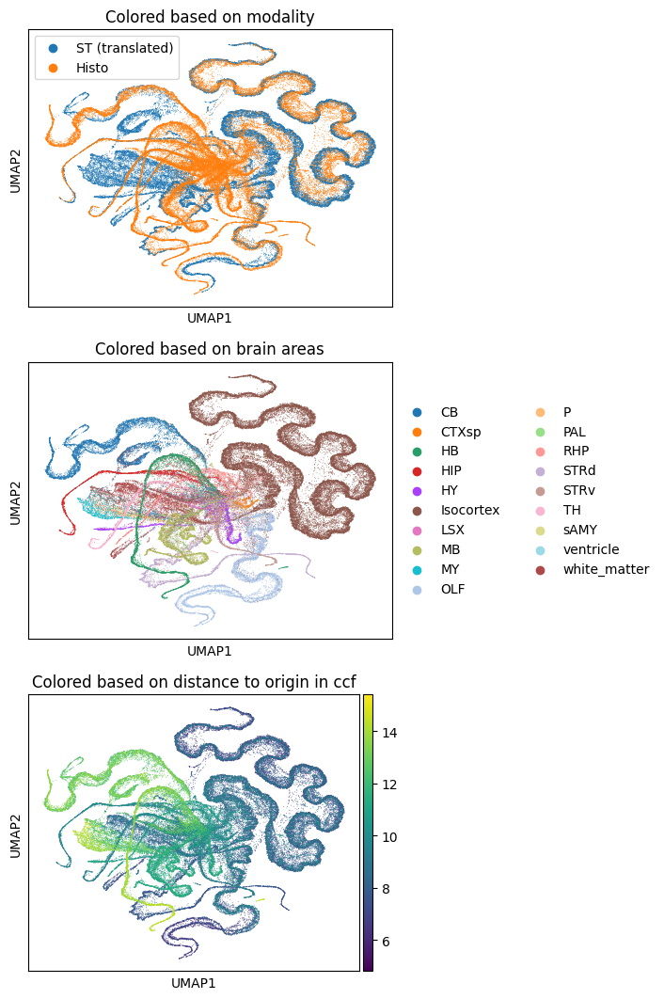

In [12]:
plot_umap(adata_st, adata_histo, st_3, histo_3)
plt.show()

#### Validation plot

/p/project1/hai_fzj_bda/koenig8/jupyter/kernels/contrastive_learn/lib/python3.10/site-packages/anndata/_core/anndata.py:1756: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


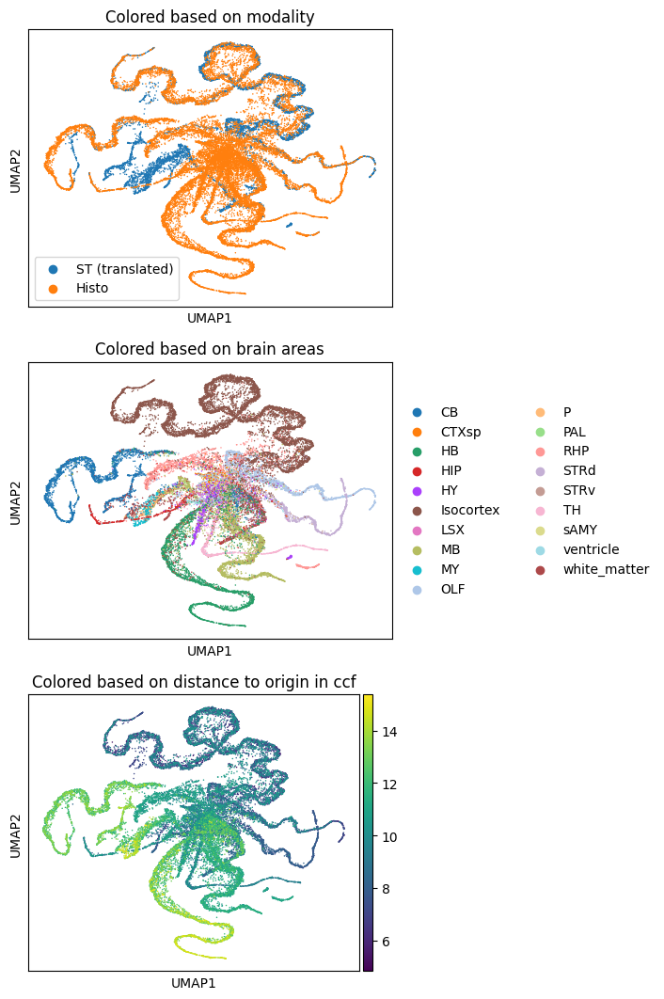

In [16]:
fig = plot_umap(ad_val_st, ad_val_histo, st_3[val_cond_st], histo_3[val_cond_histo])
plt.show()

### Coordinate scores

In [17]:
nn = NearestNeighbors(n_neighbors=1, algorithm='auto')
nn.fit(histo_3)
_, ind_model = nn.kneighbors(st_3)

# Flatten to get simple 1D arrays
ind_model = ind_model.flatten()

OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detec

In [20]:
float(np.mean(paired_distances(st_points, histo_points[ind_model])))

3.289205372657535

In [21]:
r2_score(st_points, histo_points[ind_model])

-0.243520129371929

==> Even worse than the UMAP model

In [25]:
np.vstack((st_3, histo_3)).shape

(100000, 480)

In [28]:
silhouette_score(
    np.vstack((st_3, histo_3)), labels=np.concatenate((np.zeros(st_3.shape[0]), np.ones(histo_3.shape[0])))
)

np.float32(0.027439931)

# Evaluate SupCon

In [11]:
supcon_p = "/p/project1/hai_fzj_bda/koenig8/cl/supcon_2/logs/SupCon"
scores = dict()
pbar = tqdm(os.listdir(supcon_p))
progress_file = "/p/project1/hai_fzj_bda/koenig8/cl/supcon_2/eval_progress.txt"

  0%|          | 0/100 [00:00<?, ?it/s]

In [ ]:
supcon_p = "/p/project1/hai_fzj_bda/koenig8/cl/supcon_2/logs/SupCon"
scores = dict()
pbar = tqdm(os.listdir(supcon_p))
progress_file = "/p/project1/hai_fzj_bda/koenig8/cl/supcon_2/eval_progress.txt"

for version in pbar:
    tmp_p = os.path.join(supcon_p, version, "checkpoints")
    ext = [p for p in os.listdir(tmp_p) if "epoch" in p][0]
    checkpoint = os.path.join(tmp_p, ext)
    model = SimCLR.load_from_checkpoint(checkpoint)
    model.eval()
    st, histo = embed_data(model, adata_st, adata_histo)

    nn = NearestNeighbors(n_neighbors=1, algorithm='auto')
    nn.fit(histo)
    _, ind_model = nn.kneighbors(st)
    ind_model = ind_model.flatten()
    scores[version] = float(r2_score(st_points, histo_points[ind_model]))
    with open(progress_file, 'a+') as f:
        f.write(f"{version}: {scores[version]:.4f}")
        f.write("\n")
    pbar.set_description(f"{version}: {scores[version]:.4f}")

OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detec

```
version_93: -0.0644
version_37: -0.1981
version_24: -0.0839
version_29: -0.1846
version_89: -1.2379
version_79: -0.7706
version_30: -0.9460
version_57: -0.9174
version_33: -0.8783
version_92: -0.8549
version_60: -0.0790
version_56: -1.0200
version_81: -1.0475
version_66: -1.1542
version_62: -0.1040
```

### Use version 93

In [15]:
tmp_p = os.path.join(supcon_p, "version_93", "checkpoints")
ext = [p for p in os.listdir(tmp_p) if "epoch" in p][0]
checkpoint = os.path.join(tmp_p, ext)

model = SimCLR.load_from_checkpoint(checkpoint)
model.eval()
st, histo = embed_data(model, adata_st, adata_histo)

/p/project1/hai_fzj_bda/koenig8/jupyter/kernels/contrastive_learn/lib/python3.10/site-packages/anndata/_core/anndata.py:1756: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


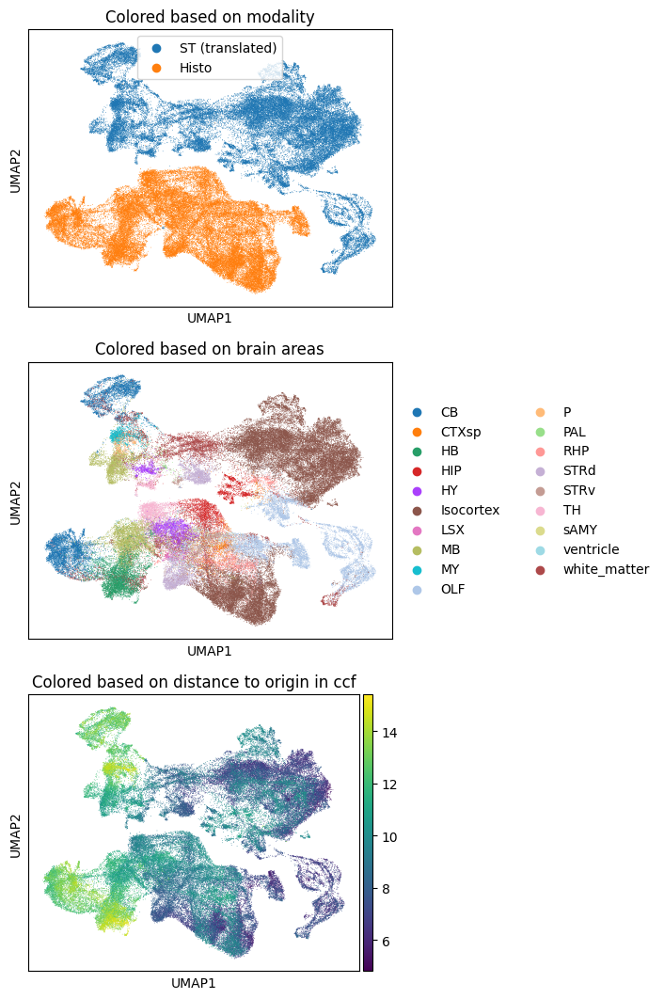

In [16]:
fig = plot_umap(adata_st, adata_histo, st, histo)
plt.show()